In [65]:
import os
os.listdir('/content/drive/MyDrive/bears')

OSError: ignored

In [1]:
!pip install -Uqq fastbook
import fastbook
fastbook.setup_book()
from fastbook import *
from fastai.vision.widgets import *

/Users/darchcruise/opt/anaconda3/lib/python3.8/site-packages/fastbook/__init__.py:18: UserWarning: Missing `graphviz` - please run `conda install fastbook`
  except ModuleNotFoundError: warn("Missing `graphviz` - please run `conda install fastbook`")


In [113]:
os.listdir('/content/gdrive/MyDrive/bears')

['black', 'teddy', 'grizzly', 'human']

In [2]:
path = Path('/content/gdrive/MyDrive/bears')

In [4]:
fns = get_image_files(path)
fns

(#0) []

In [116]:
failed = verify_images(fns)
failed

(#0) []

In [ ]:
failed.map(Path.unlink);

In [117]:
bears = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128))

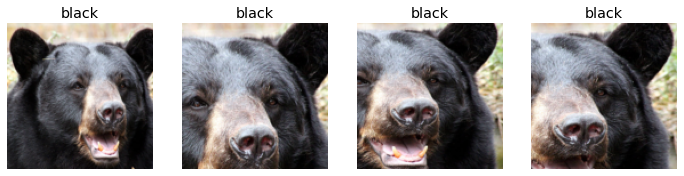

In [118]:
bears = bears.new(item_tfms=RandomResizedCrop(128, min_scale=0.3))
dls = bears.dataloaders(path)
dls.train.show_batch(max_n=4, nrows=1, unique=True)

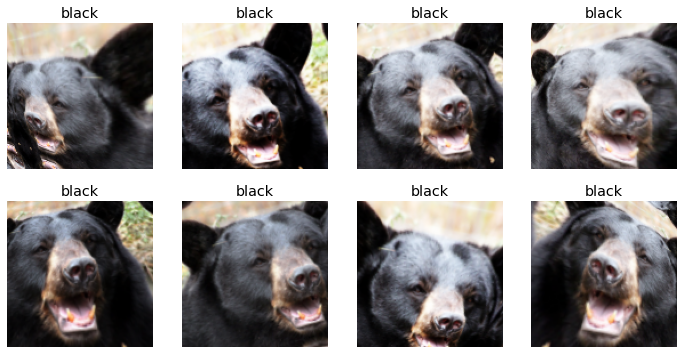

In [119]:
bears = bears.new(item_tfms=Resize(128), batch_tfms=aug_transforms(mult=2))
dls = bears.dataloaders(path)
dls.train.show_batch(max_n=8, nrows=2, unique=True)

In [120]:
bears = bears.new(
    item_tfms=RandomResizedCrop(224, min_scale=0.5),
    batch_tfms=aug_transforms())
dls = bears.dataloaders(path)

In [121]:
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.466960,0.413089,0.162500,01:23


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


epoch,train_loss,valid_loss,error_rate,time
0,0.283256,0.217016,0.075000,01:47
1,0.209382,0.081322,0.037500,01:53
2,0.165426,0.059601,0.025000,01:50
3,0.121596,0.059018,0.025000,01:49


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


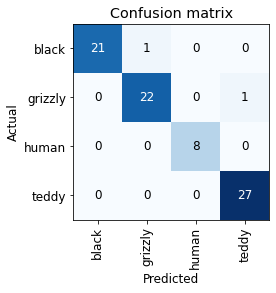

In [122]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

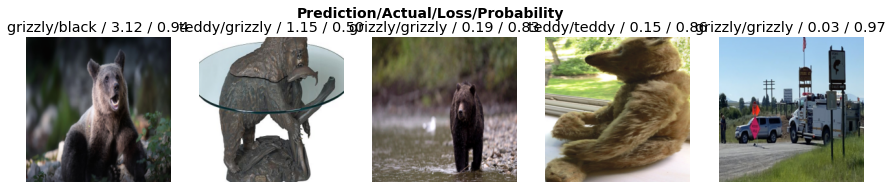

In [123]:
interp.plot_top_losses(5, nrows=1)

In [124]:
cleaner = ImageClassifierCleaner(learn)
cleaner

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


In [125]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()

In [126]:
learn.export()

In [127]:
path = Path()
path.ls(file_exts='.pkl')

(#1) [Path('export.pkl')]

In [128]:
learn_inf = load_learner(path/'export.pkl')

In [137]:
uploader = widgets.FileUpload()
uploader

FileUpload(value={}, description='Upload')

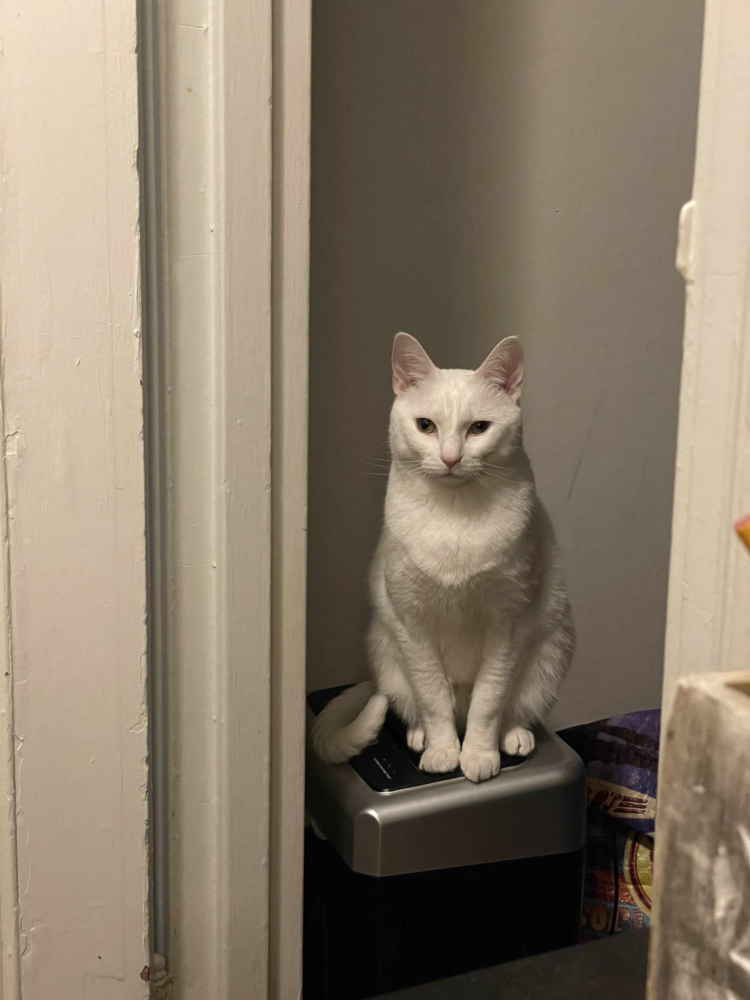

In [165]:
img = PILImage.create(uploader.data[0])
img

In [166]:
learn_inf.predict(img)

('human', tensor(2), tensor([0.0787, 0.0590, 0.8148, 0.0476]))

In [167]:
pred,pred_idx,probs = learn_inf.predict(img)

lbl_pred = widgets.Label()
lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'
lbl_pred

Label(value='Prediction: human; Probability: 0.8148')